In [2]:
from player import player_1, player_2
from ultimatum import ultimatum
import plotly.express as px
import plotly.figure_factory as ff
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd

## Game

In [3]:
endowment = 100
epsilon = 0.1
alpha = 0.2
policy = 0.2

In [4]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate = alpha,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate = alpha,states = endowment)

game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [5]:
game.play()
game.results["B's action"] = game.results["B's action"].astype(str)
game.results

,A's offer,B's action,B's average actions,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0.000000,0,0,0,0
1,35,0,0.000000,0,0,0,0
2,0,0,0.000000,0,0,0,0
3,0,0,0.000000,0,0,0,0
4,0,0,0.000000,0,0,0,0
...,...,...,...,...,...,...,...
9995,37,1,0.857843,63,37,688872,168628
9996,19,1,0.857857,81,19,688953,168647
9997,19,1,0.857872,81,19,689034,168666
9998,19,1,0.857886,81,19,689115,168685


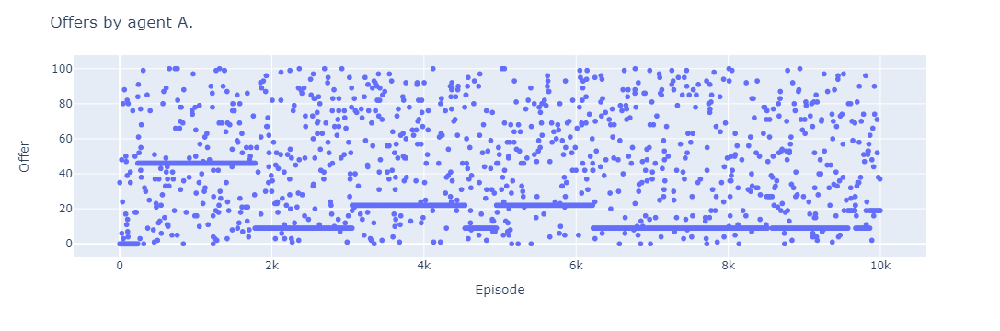

In [6]:
fig = px.scatter(game.results, y="A's offer")
fig.update_layout(title = "Offers by agent A.",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

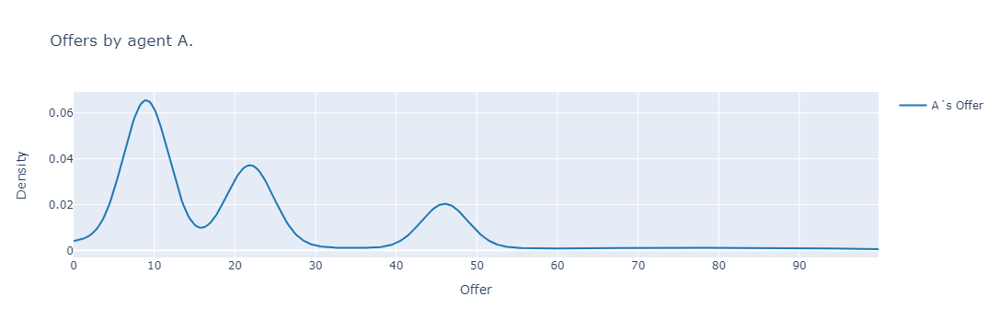

In [7]:
fig = ff.create_distplot([game.results["A's offer"]],group_labels = ["A´s Offer"],bin_size=10,show_hist = False, show_rug=False)
fig.update_layout(title = "Offers by agent A.",xaxis_title="Offer",yaxis_title = "Density")
fig.show()

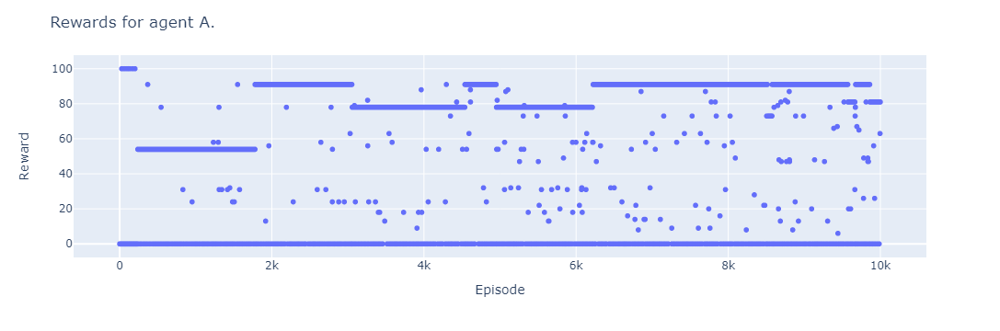

In [8]:
fig = px.scatter(game.results, y="A's reward")
fig.update_layout(title = "Rewards for agent A.",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

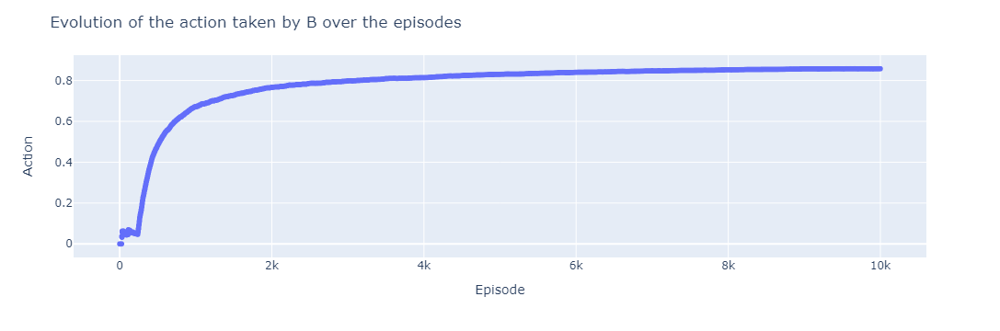

In [9]:
fig = px.scatter(game.results, y="B's average actions")
fig.update_layout(title = "Evolution of the action taken by B over the episodes",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

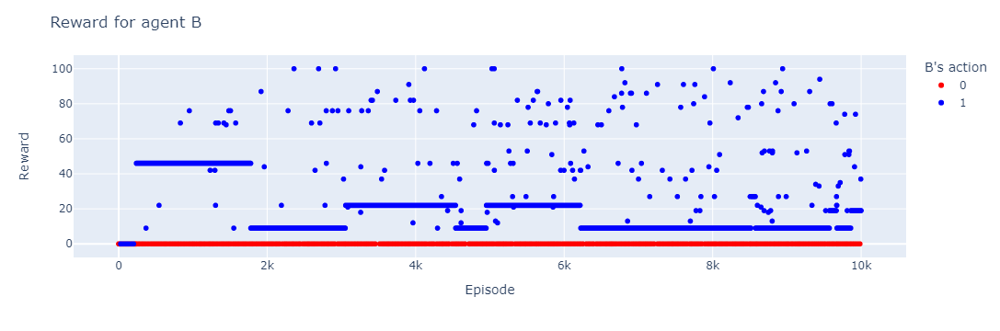

In [10]:
fig = px.scatter(game.results, y="B's reward", color = "B's action", color_discrete_sequence = ["red","blue"])
fig.update_layout(title = "Reward for agent B",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

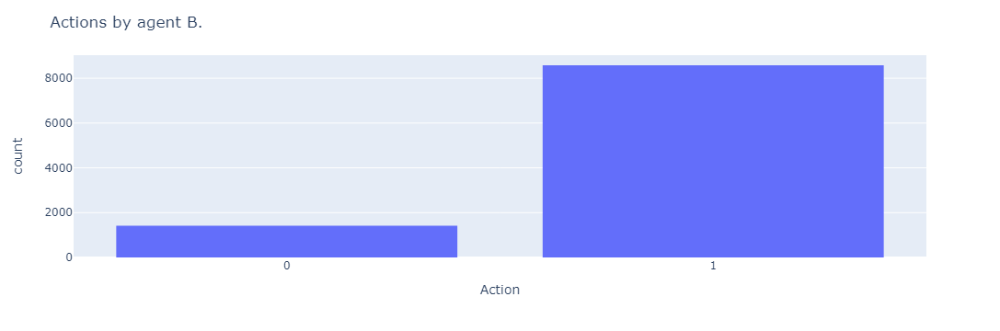

In [11]:
fig = px.histogram(game.results, x = "B's action")
fig.update_layout(title = "Actions by agent B.",xaxis_title="Action")
fig.show()

### Exploring epsilon

In [20]:
endowment = 100
alpha = 0.2
n_simulations = 50
policy = 0.2

In [21]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = []

for epsilon in list([0.01,0.1,0.5,1]):
    
    agent_a_actions = []
    agent_b_actions = []
    agent_a_rewards = []
    agent_b_rewards = []

    for i in range(n_simulations):
        agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
        agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
        game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
        game.play()
        agent_a_actions.append(game.player_1_actions)
        agent_b_actions.append(game.player_2_actions)
        agent_a_rewards.append(game.player_1_rewards)
        agent_b_rewards.append(game.player_2_rewards)
    
    average_a_actions = np.mean(agent_a_actions, axis=0)
    average_a_actions_dynamic.append(average_a_actions)
    
    average_b_actions = np.mean(agent_b_actions, axis = 0)
    average_b_actions_dynamic.append(average_b_actions)
    
    average_a_rewards = np.mean(agent_a_rewards, axis = 0)
    average_a_rewards_dynamic.append(average_a_rewards)
    
    average_b_rewards = np.mean(agent_b_rewards, axis = 0)
    average_b_rewards_dynamic.append(average_b_rewards)
    
    names.append(f"epsilon = {epsilon}")

In [22]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

In [23]:
df_average_actions_a.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.00,4.24,19.80,54.66
1,1.76,4.74,27.32,49.22
2,0.00,1.16,24.92,49.60
3,0.00,6.68,32.66,47.44
4,0.00,10.44,30.56,49.52


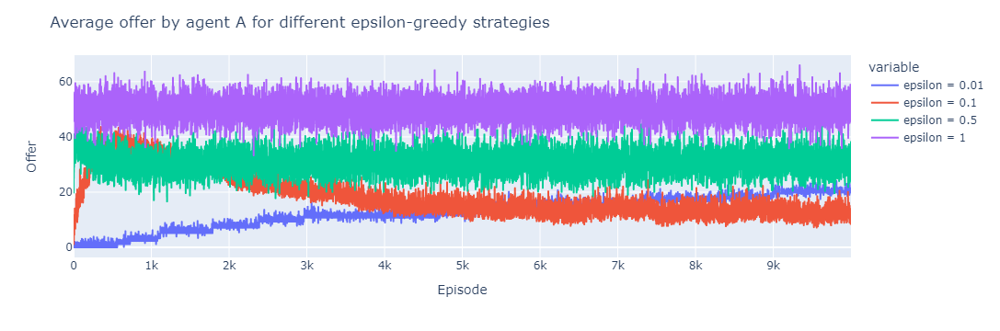

In [24]:
fig = px.line(df_average_actions_a,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"])
fig.update_layout(title = "Average offer by agent A for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

In [25]:
df_average_rewards_a.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.0,2.00,31.12,23.28
1,2.0,4.00,15.00,18.22
2,0.0,8.00,22.60,31.56
3,0.0,2.38,18.50,19.64
4,2.0,3.98,23.88,32.70


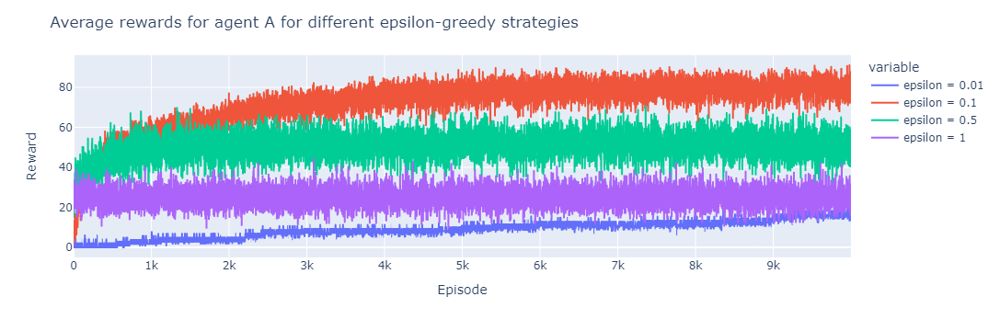

In [26]:
fig = px.line(df_average_rewards_a,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"])
fig.update_layout(title = "Average rewards for agent A for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

In [27]:
df_average_actions_b.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.00,0.02,0.40,0.48
1,0.02,0.04,0.24,0.44
2,0.00,0.08,0.34,0.60
3,0.00,0.04,0.30,0.42
4,0.02,0.08,0.40,0.48


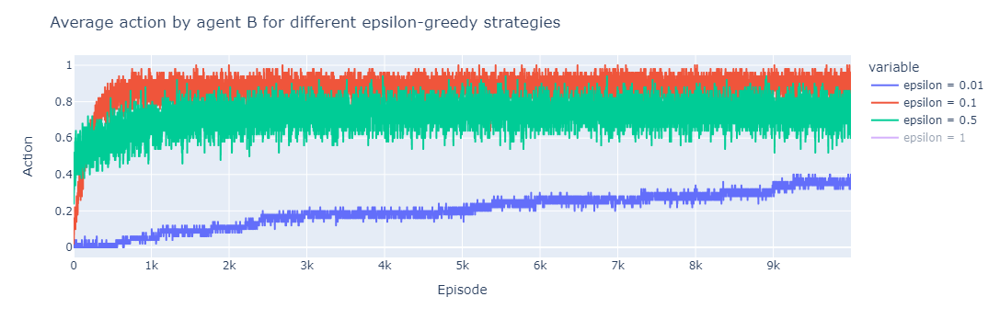

In [28]:
fig = px.line(df_average_actions_b,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5","epsilon = 1"])
fig.update_layout(title = "Average action by agent B for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

In [29]:
df_average_rewards_b.head()

,epsilon = 0.01,epsilon = 0.1,epsilon = 0.5,epsilon = 1
0,0.0,0.00,8.88,24.72
1,0.0,0.00,9.00,25.78
2,0.0,0.00,11.40,28.44
3,0.0,1.62,11.50,22.36
4,0.0,4.02,16.12,15.30


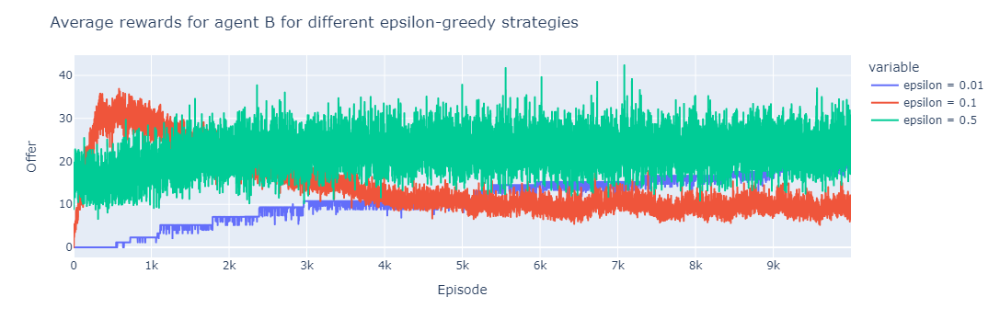

In [33]:
fig = px.line(df_average_rewards_b,y=["epsilon = 0.01","epsilon = 0.1","epsilon = 0.5"])
fig.update_layout(title = "Average rewards for agent B for different epsilon-greedy strategies",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

### Exploring alpha

In [2]:
endowment = 100
epsilon = 0.1
n_simulations = 50
policy = 0.2

In [3]:
average_a_actions_dynamic = []
average_b_actions_dynamic = []
average_a_rewards_dynamic = []
average_b_rewards_dynamic = []

names = []

for alpha in list([0.01,0.1,0.5,1]):
    
    agent_a_actions = []
    agent_b_actions = []
    agent_a_rewards = []
    agent_b_rewards = []

    for i in range(n_simulations):
        agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha,actions = endowment)
        agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha,states = endowment)
        game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)
        game.play()
        agent_a_actions.append(game.player_1_actions)
        agent_b_actions.append(game.player_2_actions)
        agent_a_rewards.append(game.player_1_rewards)
        agent_b_rewards.append(game.player_2_rewards)
    
    average_a_actions = np.mean(agent_a_actions, axis=0)
    average_a_actions_dynamic.append(average_a_actions)
    
    average_b_actions = np.mean(agent_b_actions, axis = 0)
    average_b_actions_dynamic.append(average_b_actions)
    
    average_a_rewards = np.mean(agent_a_rewards, axis = 0)
    average_a_rewards_dynamic.append(average_a_rewards)
    
    average_b_rewards = np.mean(agent_b_rewards, axis = 0)
    average_b_rewards_dynamic.append(average_b_rewards)
    
    names.append(f"alpha = {alpha}")

In [4]:
df_average_actions_a = pd.DataFrame(data = average_a_actions_dynamic).transpose()
df_average_actions_a.columns = names
df_average_actions_b = pd.DataFrame(data = average_b_actions_dynamic).transpose()
df_average_actions_b.columns = names
df_average_rewards_a = pd.DataFrame(data = average_a_rewards_dynamic).transpose()
df_average_rewards_a.columns = names
df_average_rewards_b = pd.DataFrame(data = average_b_rewards_dynamic).transpose()
df_average_rewards_b.columns = names

In [5]:
df_average_actions_a.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,2.38,7.38,10.42,3.30
1,1.80,4.34,7.82,7.82
2,1.88,6.96,3.80,3.80
3,7.68,5.70,5.66,10.16
4,2.76,6.36,6.68,6.74


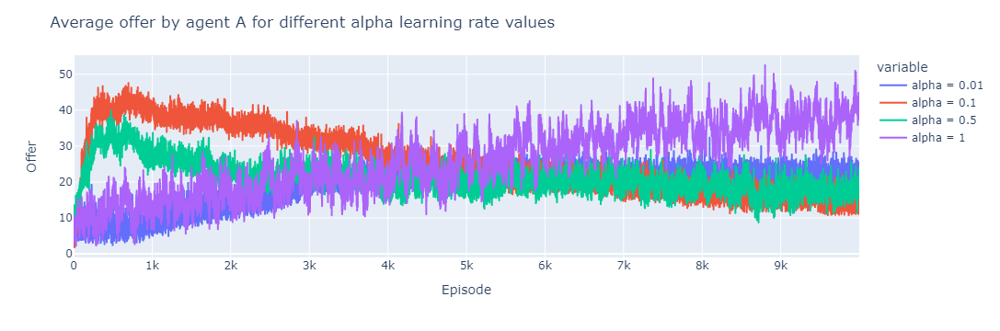

In [6]:
fig = px.line(df_average_actions_a,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average offer by agent A for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

In [7]:
df_average_rewards_a.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,10.00,4.26,8.0,3.18
1,10.00,2.26,2.0,1.18
2,0.00,10.26,8.0,6.08
3,7.92,2.26,6.0,4.08
4,9.92,2.26,2.0,6.08


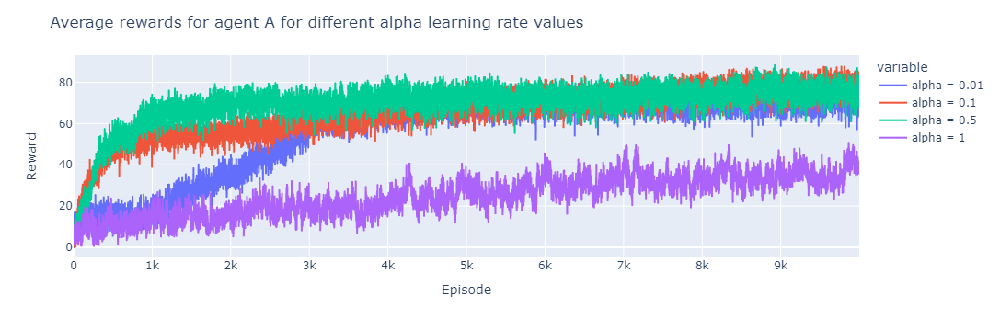

In [8]:
fig = px.line(df_average_rewards_a,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average rewards for agent A for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

In [9]:
df_average_actions_b.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.10,0.06,0.08,0.04
1,0.10,0.04,0.02,0.02
2,0.00,0.12,0.08,0.08
3,0.08,0.04,0.06,0.06
4,0.10,0.04,0.02,0.08


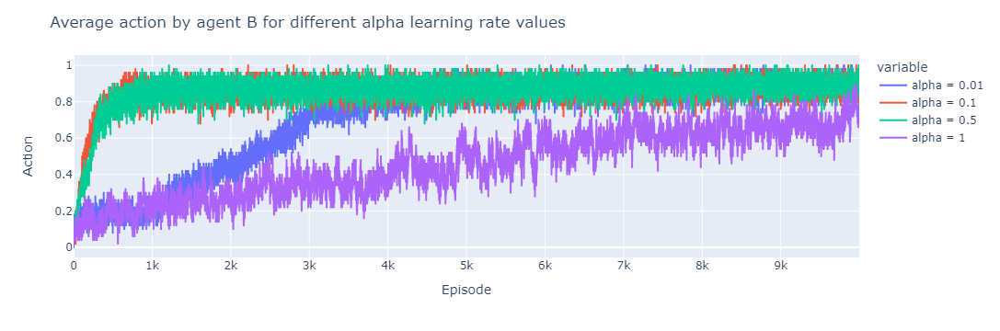

In [10]:
fig = px.line(df_average_actions_b,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average action by agent B for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

In [11]:
df_average_rewards_b.head()

,alpha = 0.01,alpha = 0.1,alpha = 0.5,alpha = 1
0,0.00,1.74,0.0,0.82
1,0.00,1.74,0.0,0.82
2,0.00,1.74,0.0,1.92
3,0.08,1.74,0.0,1.92
4,0.08,1.74,0.0,1.92


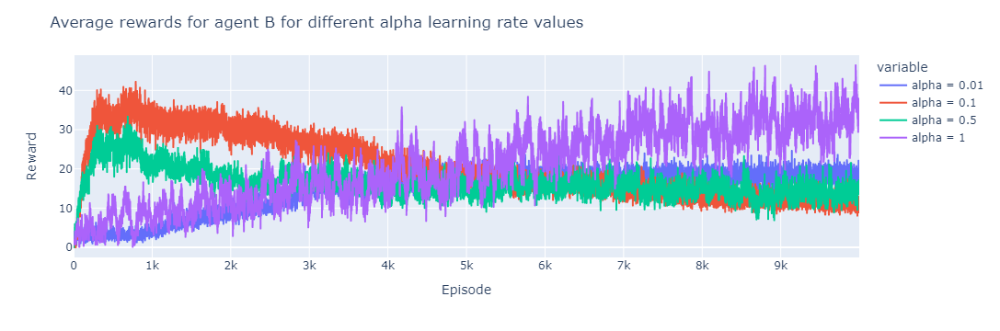

In [14]:
fig = px.line(df_average_rewards_b,y=["alpha = 0.01","alpha = 0.1","alpha = 0.5","alpha = 1"])
fig.update_layout(title = "Average rewards for agent B for different alpha learning rate values",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

### New game with best parameters for each player

In [12]:
endowment = 100
epsilon = 0.1
alpha_a = 0.5
alpha_b = 1
policy = 0.2

In [13]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha_a,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha_b,states = endowment)

game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [14]:
game.play()
game.results["B's action"] = game.results["B's action"].astype(str)
game.results

,A's offer,B's action,B's average actions,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0.000000,0,0,0,0
1,0,0,0.000000,0,0,0,0
2,9,0,0.000000,0,0,0,0
3,0,0,0.000000,0,0,0,0
4,0,0,0.000000,0,0,0,0
...,...,...,...,...,...,...,...
9995,3,1,0.865346,97,3,703281,161719
9996,3,1,0.865360,97,3,703378,161722
9997,3,1,0.865373,97,3,703475,161725
9998,3,1,0.865387,97,3,703572,161728


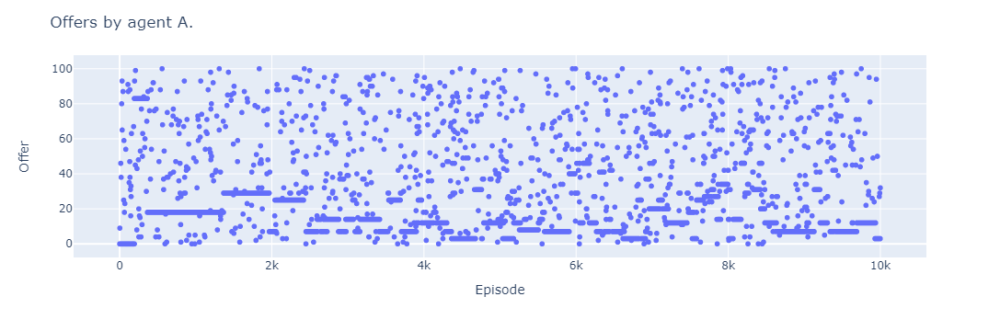

In [15]:
fig = px.scatter(game.results, y="A's offer")
fig.update_layout(title = "Offers by agent A.",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

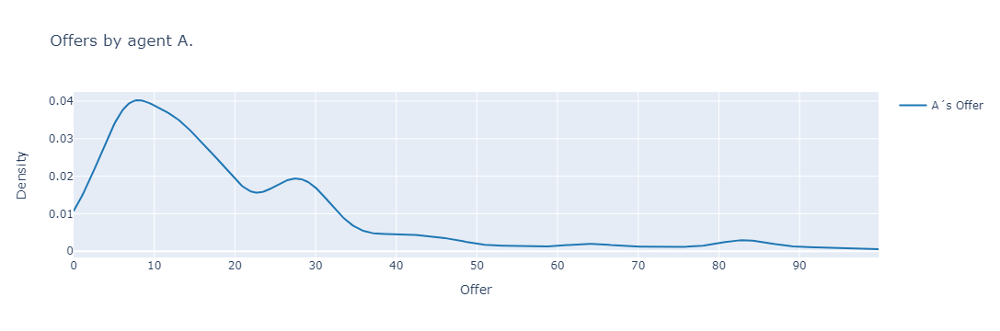

In [16]:
fig = ff.create_distplot([game.results["A's offer"]],group_labels = ["A´s Offer"],bin_size=10,show_hist = False, show_rug=False)
fig.update_layout(title = "Offers by agent A.",xaxis_title="Offer",yaxis_title = "Density")
fig.show()

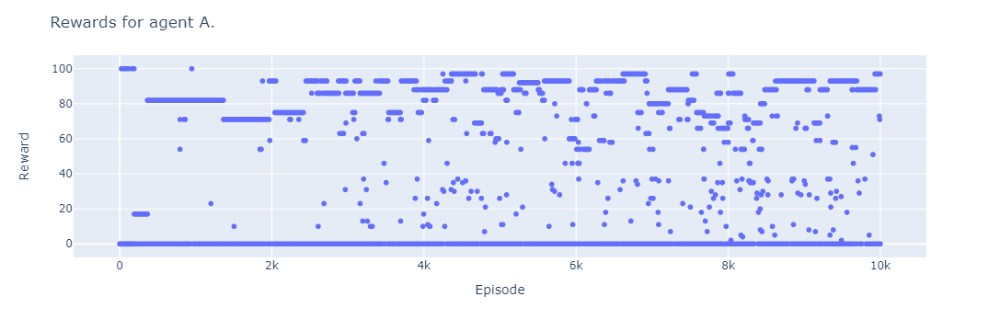

In [17]:
fig = px.scatter(game.results, y="A's reward")
fig.update_layout(title = "Rewards for agent A.",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

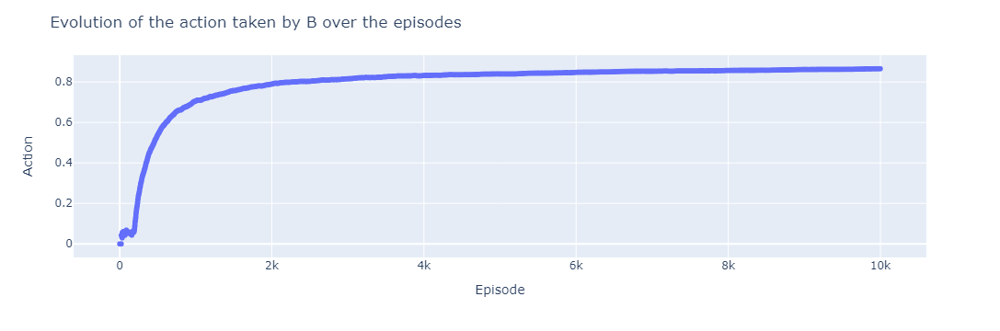

In [18]:
fig = px.scatter(game.results, y="B's average actions")
fig.update_layout(title = "Evolution of the action taken by B over the episodes",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

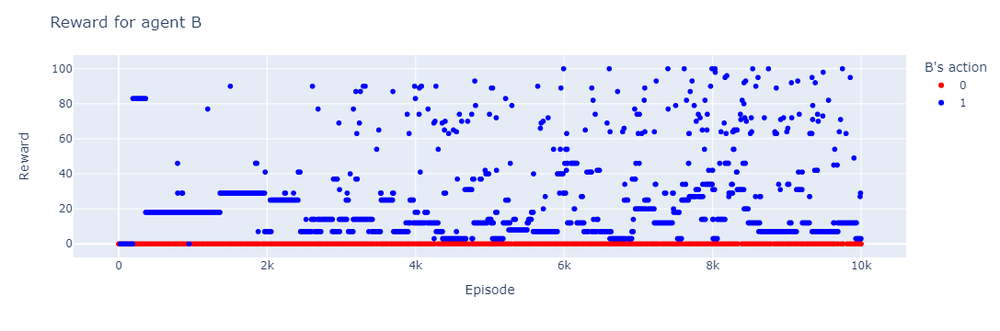

In [19]:
fig = px.scatter(game.results, y="B's reward", color = "B's action", color_discrete_sequence = ["red","blue"])
fig.update_layout(title = "Reward for agent B",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

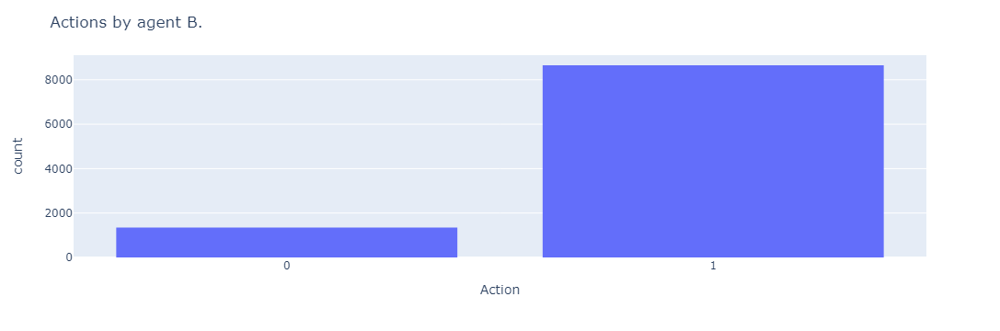

In [20]:
fig = px.histogram(game.results, x = "B's action")
fig.update_layout(title = "Actions by agent B.",xaxis_title="Action")
fig.show()

### Fixed rules

In [21]:
endowment = 100
epsilon = 0.1
alpha_a = 0.5
alpha_b = 1
policy = 0.2

In [22]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha_a,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha_b,states = endowment)

In [23]:
from types import MethodType

In [24]:
def move_fixed_policy(self, state, p):
    endowment = self.states
    if state > p*endowment:
        action = 1
    else:
        action = 0 
    return action

agent_b.move = MethodType(move_fixed_policy,agent_b)

In [25]:
game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [26]:
game.play()
game.results["B's action"] = game.results["B's action"].astype(str)
game.results

,A's offer,B's action,B's average actions,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0.000000,0,0,0,0
1,71,1,0.500000,29,71,29,71
2,71,1,0.666667,29,71,58,142
3,71,1,0.750000,29,71,87,213
4,86,1,0.800000,14,86,101,299
...,...,...,...,...,...,...,...
9995,21,1,0.979292,79,21,714752,264148
9996,21,1,0.979294,79,21,714831,264169
9997,21,1,0.979296,79,21,714910,264190
9998,21,1,0.979298,79,21,714989,264211


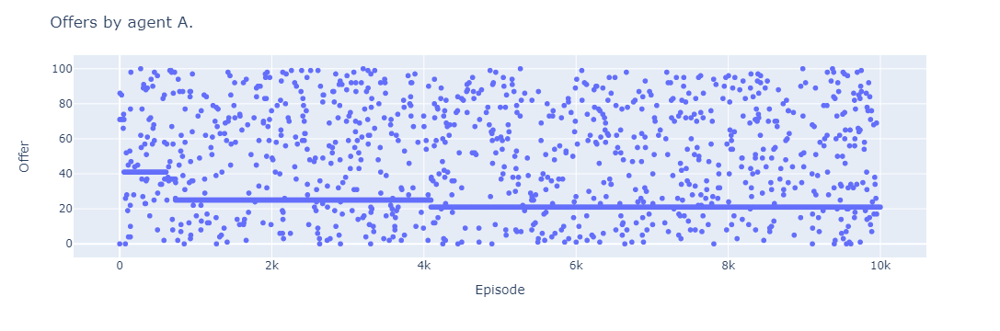

In [27]:
fig = px.scatter(game.results, y="A's offer")
fig.update_layout(title = "Offers by agent A.",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

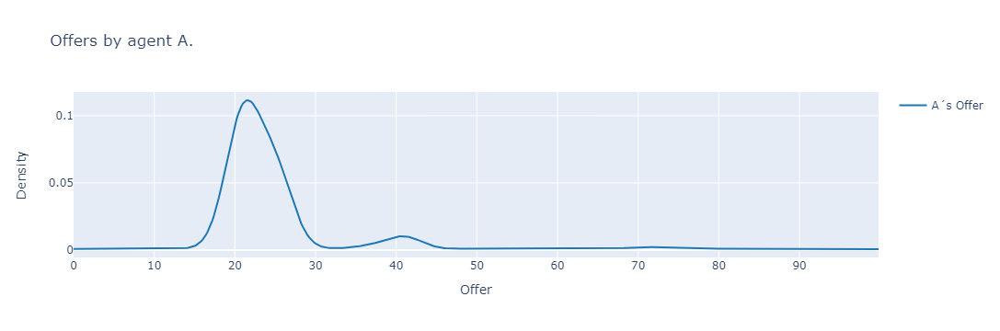

In [28]:
fig = ff.create_distplot([game.results["A's offer"]],group_labels = ["A´s Offer"],bin_size=10,show_hist = False, show_rug=False)
fig.update_layout(title = "Offers by agent A.",xaxis_title="Offer",yaxis_title = "Density")
fig.show()

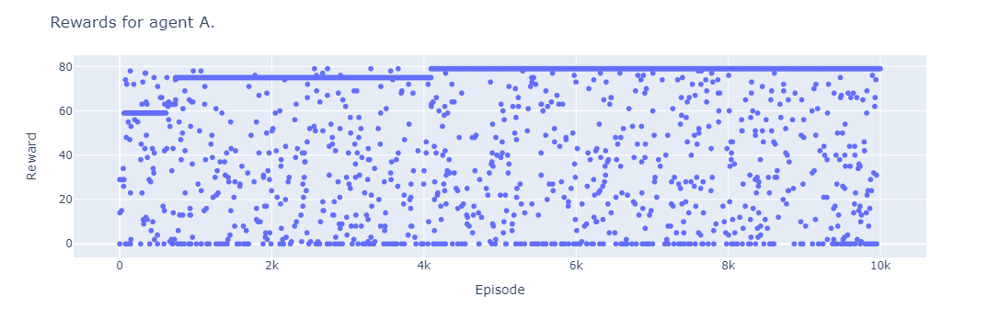

In [29]:
fig = px.scatter(game.results, y="A's reward")
fig.update_layout(title = "Rewards for agent A.",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

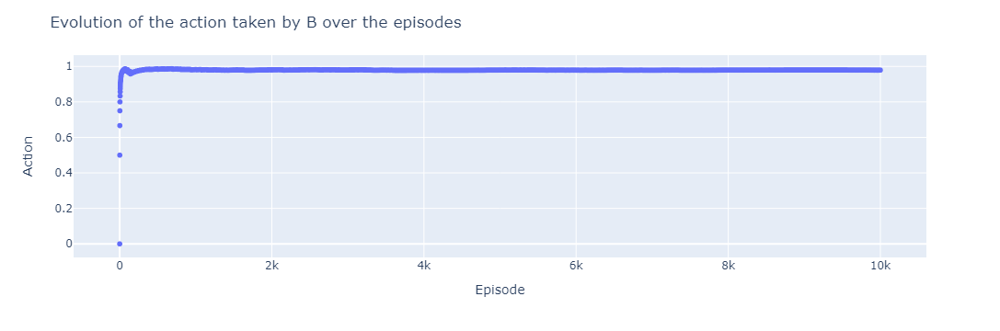

In [30]:
fig = px.scatter(game.results, y="B's average actions")
fig.update_layout(title = "Evolution of the action taken by B over the episodes",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

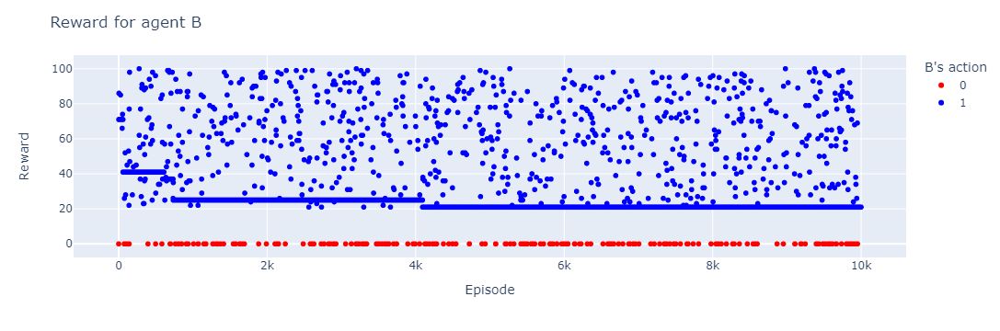

In [31]:
fig = px.scatter(game.results, y="B's reward", color = "B's action", color_discrete_sequence = ["red","blue"])
fig.update_layout(title = "Reward for agent B",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

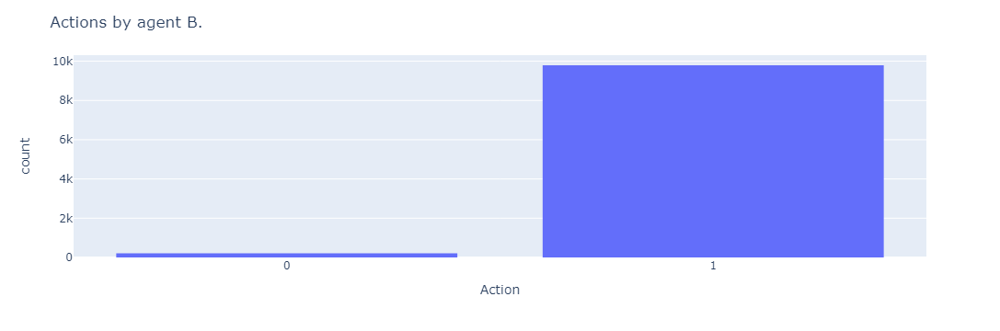

In [32]:
fig = px.histogram(game.results, x = "B's action")
fig.update_layout(title = "Actions by agent B.",xaxis_title="Action")
fig.show()

### Dynamic Rules

In [33]:
endowment = 100
epsilon = 0.1
alpha_a = 0.5
alpha_b = 1
policy = 0.4

In [34]:
agent_a = player_1(epsilon = epsilon, alpha_learn_rate=alpha_a,actions = endowment)

agent_b = player_2(epsilon = epsilon,alpha_learn_rate=alpha_b,states = endowment)

In [35]:
from types import MethodType

In [36]:
def move_fixed_policy(self, state, p):
    endowment = self.states
    if state > p*endowment:
        action = 1
    else:
        action = 0 
    return action

agent_b.move = MethodType(move_fixed_policy,agent_b)

In [37]:
game = ultimatum(episodes = 10000, player_1 = agent_a, player_2 = agent_b, endowment = endowment, policy = policy)

In [38]:
policy_values = {2000:0.35,5000:0.45,7000:0.6,10000:0.4}

In [39]:
game.play(policy_values = policy_values, dynamic = True)
game.results["B's action"] = game.results["B's action"].astype(str)
game.results

,A's offer,B's action,B's average actions,A's reward,B's reward,A's payoffs,B's payoffs
0,0,0,0.000000,0,0,0,0
1,0,0,0.000000,0,0,0,0
2,0,0,0.000000,0,0,0,0
3,0,0,0.000000,0,0,0,0
4,0,0,0.000000,0,0,0,0
...,...,...,...,...,...,...,...
9995,63,1,0.951981,37,63,460336,491264
9996,63,1,0.951986,37,63,460373,491327
9997,63,1,0.951990,37,63,460410,491390
9998,63,1,0.951995,37,63,460447,491453


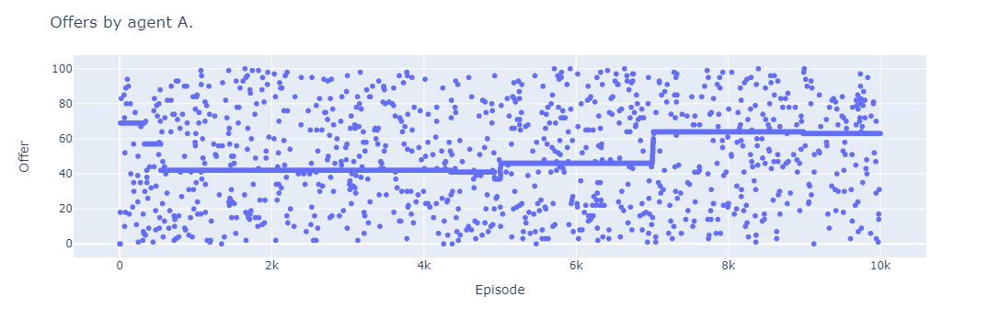

In [40]:
fig = px.scatter(game.results, y="A's offer")
fig.update_layout(title = "Offers by agent A.",xaxis_title="Episode",yaxis_title = "Offer")
fig.show()

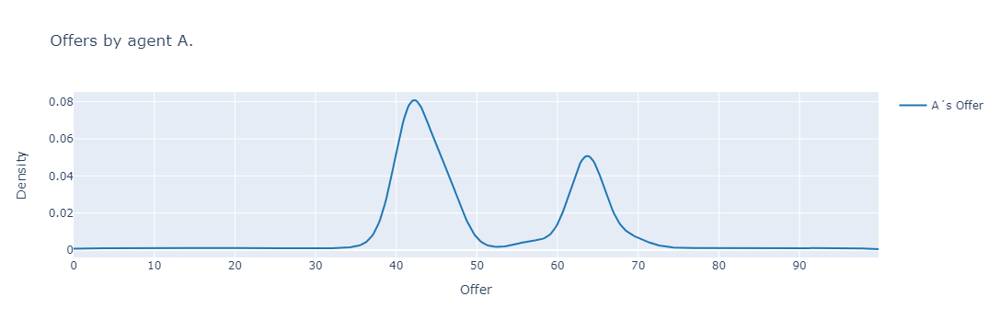

In [41]:
fig = ff.create_distplot([game.results["A's offer"]],group_labels = ["A´s Offer"],bin_size=10,show_hist = False, show_rug=False)
fig.update_layout(title = "Offers by agent A.",xaxis_title="Offer",yaxis_title = "Density")
fig.show()

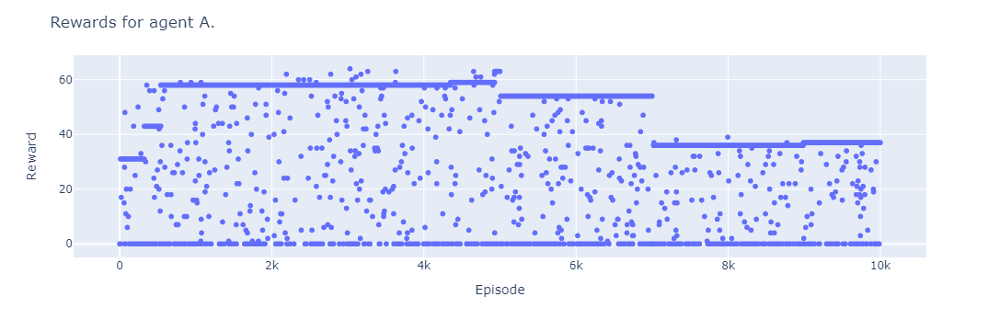

In [42]:
fig = px.scatter(game.results, y="A's reward")
fig.update_layout(title = "Rewards for agent A.",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

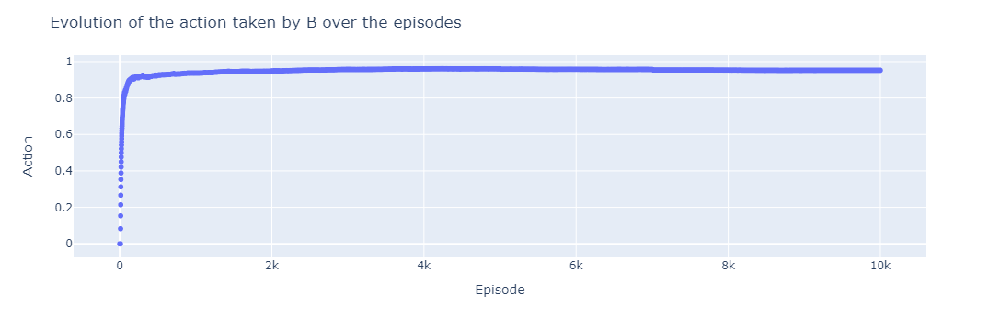

In [43]:
fig = px.scatter(game.results, y="B's average actions")
fig.update_layout(title = "Evolution of the action taken by B over the episodes",xaxis_title="Episode",yaxis_title = "Action")
fig.show()

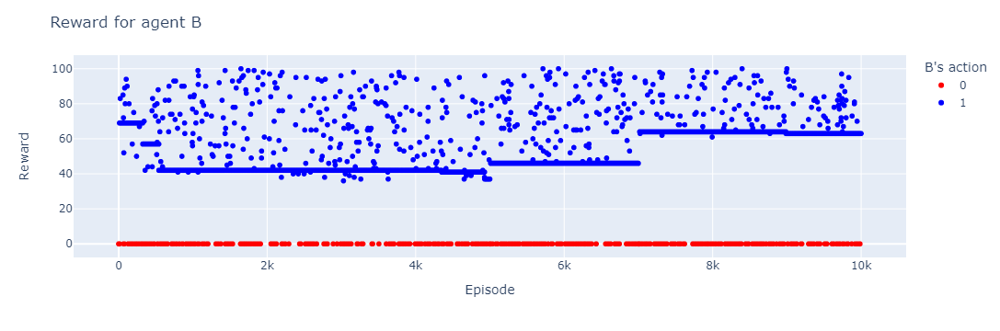

In [44]:
fig = px.scatter(game.results, y="B's reward", color = "B's action", color_discrete_sequence = ["red","blue"])
fig.update_layout(title = "Reward for agent B",xaxis_title="Episode",yaxis_title = "Reward")
fig.show()

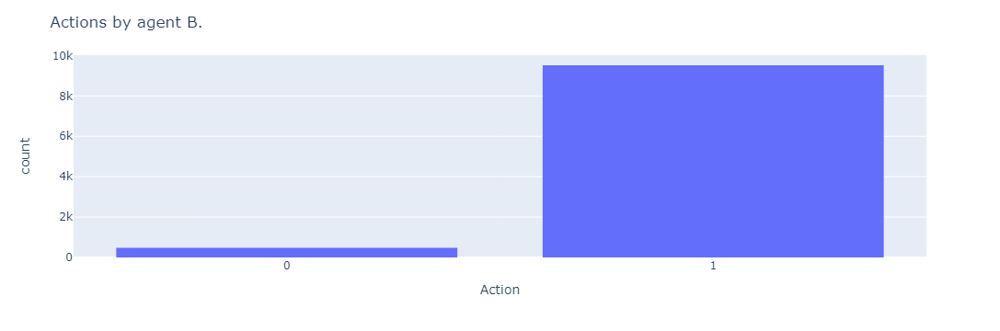

In [45]:
fig = px.histogram(game.results, x = "B's action")
fig.update_layout(title = "Actions by agent B.",xaxis_title="Action")
fig.show()

## Development

In [7]:
import numpy as np

In [17]:
x = np.zeros(shape = (1,50))
x[0][45] = 8
print(x)

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 8. 0. 0.
  0. 0.]]


In [18]:
a = list(x[0]).index(max(x[0]))
a

45

In [13]:
a = list(x[0]).index(6)
a

AttributeError: 'numpy.ndarray' object has no attribute 'type'

In [5]:
x = np.random.randint(low = 0, high = 50)
x

40

In [16]:
class dog:
    b = 0

In [17]:
maxi = dog()
print(maxi.b)

0


In [18]:
maxi.b = 58

In [14]:
name = {20:0.35,35:0.45,50:0.6,100:0.4}
name.keys()

dict_keys([20, 35, 50, 100])

In [16]:
name = {20:0.35,35:0.45,50:0.6,100:0.4}
x = 0
for i in range(100):
    if i in name.keys():
        x = name[i]
    print(x)

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.35
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.45
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6
0.6


In [9]:
def start(x, *args,**kwargs):
    if line == 1:
        print(x)
    
start(x = "this is a test",line = 0)

NameError: name 'line' is not defined